# Unsupervised analysis of latent space

# Table of Contents
- [Method from the article](#section-1-method-from-the-article)
  - [1.1 Getting started with Stylegan](#11-getting-started-with-stylegan)
  - [1.2 Implementation of GANspace](#12-implementation-of-ganspace)
  - [1.3 Results](#13-Results)
- [Attempts to disantanglement](#Attempts-to-disantanglement)
  - [Kernel PCA instead of PCA](#Kernel-PCA-instead-of-PCA)
  - [ICA after PCA](#ICA-after-PCA)
  - [Tryning to use a Variational Auto encoder instead of a PCA](##Tryning-to-use-a-Variational-Auto-encoder-instead-of-a-PCA)


In [1]:
import generate_nb
import matplotlib.pyplot as plt
import torch
import numpy as np
import dnnlib
import legacy
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import importlib

import projector_nb
importlib.reload(projector_nb)
import numpy as np
import torch
import os
import imageio
from tqdm import tqdm
import matplotlib.pyplot as plt

from joblib import dump, load
from sklearn.decomposition import KernelPCA
from sklearn.metrics.pairwise import cosine_similarity



In [2]:
print(torch.cuda.is_available())

device = torch.device('cuda:1')

print(device)

True
cuda:1



# Section 1: Method from the article

---

## 1.1 Getting started with Stylegan


In [3]:

image = generate_nb.generate_images(
    network_pkl='https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/metfaces.pkl',
    seeds=[0],  # single seed for one image
    truncation_psi=0.7,
    noise_mode='const',
    outdir='out',
    class_idx=None,
    projected_w=None,
    show=True,
    device = device
)

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/metfaces.pkl"...
Generating image for seed 0 (0/1) ...
Setting up PyTorch plugin "bias_act_plugin"... 

/home/infres/billy-22/miniconda3/envs/stylegan_gpuenv/lib/python3.12/site-packages/torch/utils/cpp_extension.py:1967: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(


Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... 

/home/infres/billy-22/miniconda3/envs/stylegan_gpuenv/lib/python3.12/site-packages/torch/utils/cpp_extension.py:1967: UserWarning: TORCH_CUDA_ARCH_LIST is not set, all archs for visible cards are included for compilation. 
If this is not desired, please set os.environ['TORCH_CUDA_ARCH_LIST'].
  warnings.warn(
/home/infres/billy-22/stylegan/torch_utils/ops/conv2d_gradfix.py:43: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at /home/conda/feedstock_root/build_artifacts/libtorch_1716579264291/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return torch.nn.functional.conv_transpose2d(input=input, weight=weight, bias=bias, stride=stride, padding=padding, output_padding=output_padding, groups=groups, dilation=dilation)


Done.


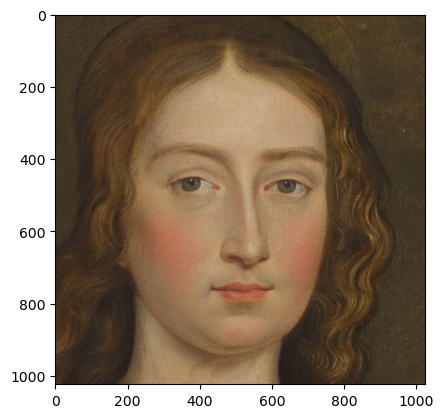

In [4]:
plt.imshow(image)

## Loading the network

In [5]:
network = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"
name = 'out/seed0085.png'
outdir = 'ignored_outputs'
#projector_nb.run_projection(network_pkl=network,target_fname=name, outdir = outdir, save_video=True, seed=1,num_steps=100,device=device)

## 1.2 Implementation of GANspace

x is the vector that has zeros everywhere excepet where the user want to modify

**PCA**: Shapes of the attributes of this class

components_ndarray of shape (n_components, n_features)

explained_variance_ndarray of shape (n_components,)

The movement is computed as follow in the article: V @ x

V: (n_components, n_features) | x: (n_features, 1)

Shape of V @ x is (n_components, 1)

In [6]:
with dnnlib.util.open_url(network) as fp:
        G = legacy.load_network_pkl(fp)['G_ema'].requires_grad_(False).to(device)

In [7]:
def generate_samples(G, num_samples):
    z_samples = np.random.RandomState().randn(num_samples, 512).astype(np.float32) 
    
    w_samples = G.mapping(torch.from_numpy(z_samples).to(device), None)  # [N, L, C]
    w_samples = w_samples.cpu().numpy()
    w_samples = w_samples[:,0,:]

    return w_samples

def get_pca(samples):
    
    scaler = StandardScaler()
    w_samples = scaler.fit_transform(samples)  

    pca = PCA(n_components=100)
    pca.fit(w_samples)

    explained_variance = pca.explained_variance_ratio_
    cumulative_explained_variance = np.cumsum(explained_variance)

    # Plot explained variance
    plt.figure(figsize=(10, 6))
    plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center',
        label='Individual Explained Variance')
    plt.step(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, where='mid',
         label='Cumulative Explained Variance')

    plt.xlabel('Principal Component Index')
    plt.ylabel('Explained Variance Ratio')
    plt.title('PCA Explained Variance')
    plt.legend(loc='best')
    plt.grid(True)
    plt.show()

    return pca , scaler

In [8]:
w_samples = generate_samples(G, 10000)

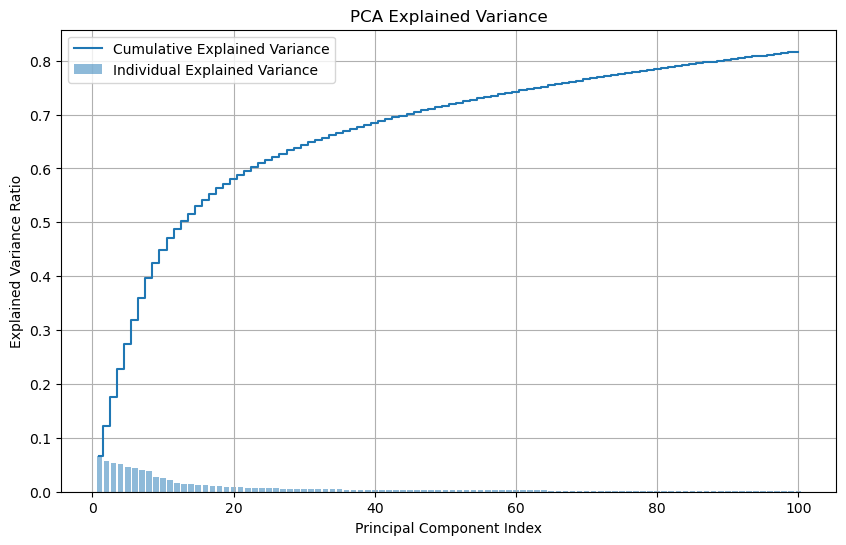

In [9]:
pca , scaler = get_pca(w_samples)

In [10]:
def move_according_to_component(G, device, pca, outdir, directions,  layers, num_steps, save_video=True, title_vid = 'proj', random_seed=None):
    os.makedirs(outdir, exist_ok=True)

    if random_seed is not None:
        np.random.seed(random_seed)

    explained_variance = pca.explained_variance_
    V = pca.components_.T
   
    # Generate a random z vector
    #z_sample = np.random.RandomState().randn(1, 512).astype(np.float32)  # select a random z vector
    z_sample = np.random.RandomState(random_seed).randn(1, 512).astype(np.float32) 
    w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

    # Generate the original image
    img_original = G.synthesis(w_sample, noise_mode='const')
    img_original = (img_original + 1) * (255 / 2)
    img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
    '''
    plt.imshow(img_original)
    plt.title('Original image')
    plt.axis('off')
    plt.show()
    '''

    # Convert w_sample to numpy and select the second element in the latent vector (w space)
    w_sample = w_sample.cpu().numpy()
    w_sample = w_sample[:, 1, :]  
    w_sample = scaler.transform(w_sample)

    img_list = []
    w_list = []

    # Initialize x
    x = np.zeros((V.shape[1], 1))
    X =  np.tile(x, (1, num_steps))

    # We use X to store the variations according to the selected dimension in one matrix 
    # as we dont move the same way on each direction

    for v in directions:
        sigma = np.sqrt(explained_variance[v])
        start_value = -2* sigma
        end_value = 2* sigma
        arrays_between = np.linspace(start_value, end_value, num_steps + 2)[1:-1]
        X[v] = arrays_between
    
   
    # each line of X correspond to a direction, the columns represent the range from -2 sigma
    # to 2 sigma
    # So the vector x of the article is one of the column of X
    
    # X.shape[0] is the number of componets
    # X.shape[1] is the number of steps from -2 sigma to 2 sigma
    
    for i in range(X.shape[1]):
        x_tmp = X[:,i]
        movement = V @ x_tmp
        movement = np.expand_dims(movement, axis=1)
      
        w_new = w_sample.T + movement
        w_new = w_new.T
        w_new = scaler.inverse_transform(w_new)
        W = np.tile(scaler.inverse_transform(w_sample), (1, 18, 1))
        W[:,layers,:] = w_new
        w_list.append(W)

    '''
    for scalar in tqdm(arrays_between):
        w_pca = pca.transform(w_sample)
        w_pca[:, component_index] += scalar
        w_new_single = pca.inverse_transform(w_pca)

        w_new = np.tile(w_new_single[:, np.newaxis, :], (1, 18, 1))
        w_list.append(w_new)
    '''
    video = imageio.get_writer(f'{outdir}/{title_vid}.mp4', mode='I', fps=10, codec='libx264', bitrate='16M')
    for w_modified in w_list:
            w_modified_tensor = torch.from_numpy(w_modified).to(device)
            synth_image = G.synthesis(w_modified_tensor, noise_mode='const')
            synth_image = (synth_image + 1) * (255 / 2)
            synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
            img_list.append(synth_image)
        

    for synthetic_image in img_list:
        video.append_data(np.concatenate([img_original, synthetic_image], axis=1))

    if save_video: 
        print("Editing video ...")
        os.makedirs(outdir, exist_ok=True)
        print(f'Saving optimization progress video "{outdir}/{title_vid}.mp4"')
        
        video.close()
        print("Video saved")
    
    return img_list, X

In [11]:
#### Visualization of the X matrix used to move along different directions

explained_variance = pca.explained_variance_
V = pca.components_.T
x = np.zeros((V.shape[1], 1))
X =  np.tile(x, (1, 10))
directions = [0,3]
for v in directions:
    sigma = explained_variance[v]
    start_value = -2* sigma
    end_value = 2* sigma
    arrays_between = np.linspace(start_value, end_value, 10 + 2)[1:-1]
    X[v] = arrays_between

for i in range(X.shape[0]):
    x_tmp = X[i,:]
    print(x_tmp)

[-54.83554771 -42.64987044 -30.46419317 -18.2785159   -6.09283863
   6.09283863  18.2785159   30.46419317  42.64987044  54.83554771]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[-42.71048979 -33.21926984 -23.72804989 -14.23682993  -4.74560998
   4.74560998  14.23682993  23.72804989  33.21926984  42.71048979]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

In [12]:
def plot_results(img_list, X_list, num_images_plot=10):
   
    # Determine the indices of images to plot
    indices = np.linspace(0, len(img_list) - 1, num=num_images_plot, dtype=int)
    
    # Plot the images
    n_cols = 5
    n_rows = (num_images_plot + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()

    for i, idx in enumerate(indices):
        axes[i].imshow(img_list[idx])
        axes[i].axis('off')

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

This code allows to move on different directions at the same time, according to the variance in the corresponding dimension.
All coordinates of x moves at the same ratio from $-2 \sigma$ to $2 \sigma$. 

Editing video ...
Saving optimization progress video "output_directory_pca/test.mp4"
Video saved


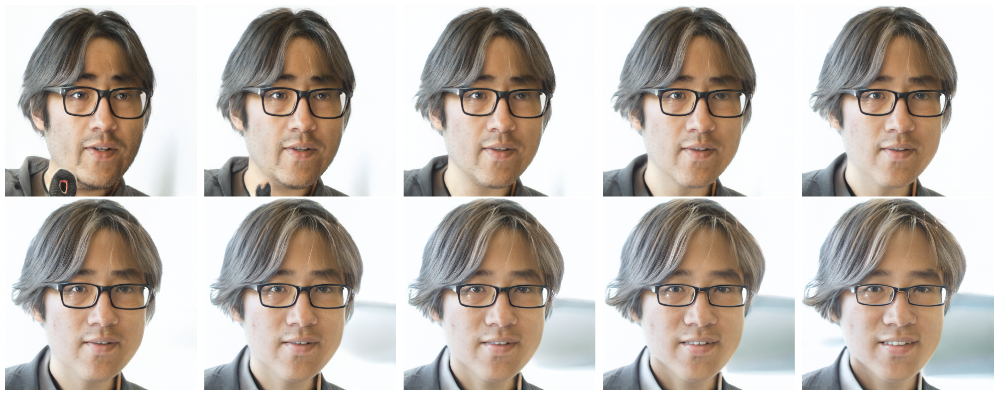

In [16]:
# Test
directions = [8]
layers =list(range(0, 18))
img_list , X_list = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='test',random_seed=2)

plot_results(img_list, X_list)

## 1.3 Results

### **One direction and all layers**


#### v0 direction: Gender

The gender evolves from a woman to a man, glasses appear, hair change

Editing video ...
Saving optimization progress video "output_directory_pca/gender_all.mp4"
Video saved


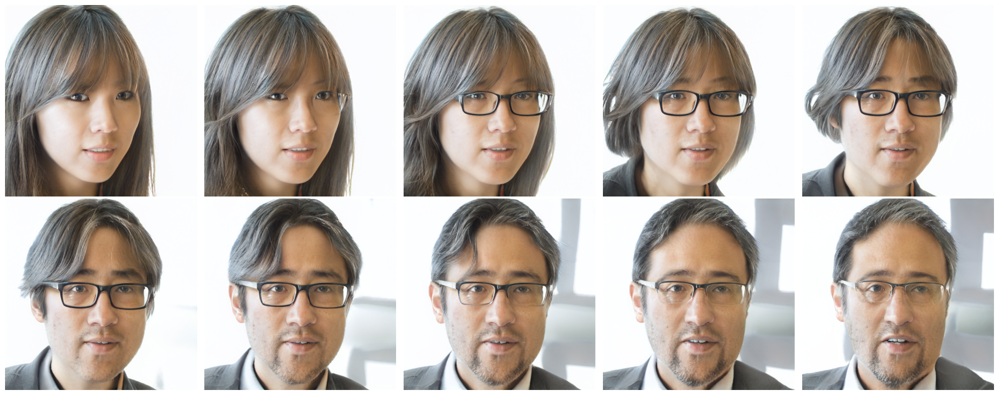

In [25]:
#Gender 
directions = [0]
layers =list(range(0, 18))
img_list_gender , X_list_gender = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_all',random_seed=2)


plot_results(img_list_gender, X_list_gender)

#### v1 direction: Gender and rotate

Editing video ...
Saving optimization progress video "output_directory_pca/gender_rotate_all.mp4"
Video saved


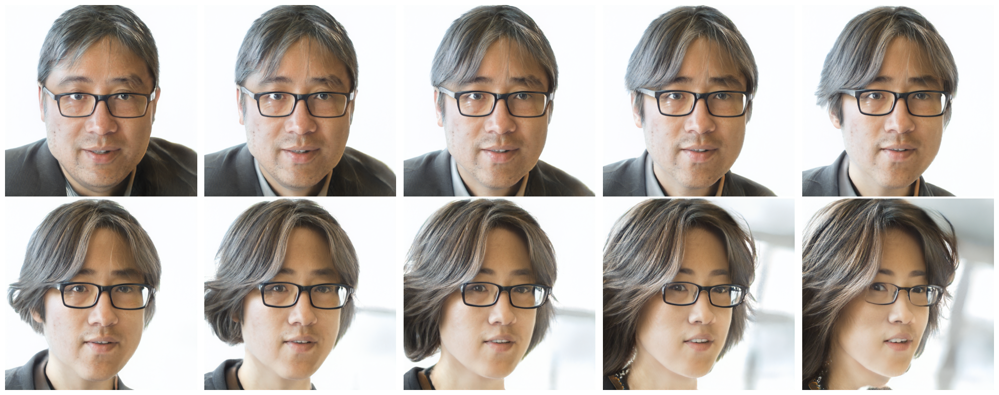

In [26]:
#Gender and rotate
directions = [1]
layers =list(range(0, 18))
img_list_gender_rotate ,X_list_gender_rotate = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_rotate_all',random_seed=2)

plot_results(img_list_gender_rotate, X_list_gender_rotate)

#### v2 direction: Gender, rotate, age, background

Age here is more visible as we explore the v2 directions

Editing video ...
Saving optimization progress video "output_directory_pca/gender_rotate_age_all.mp4"
Video saved


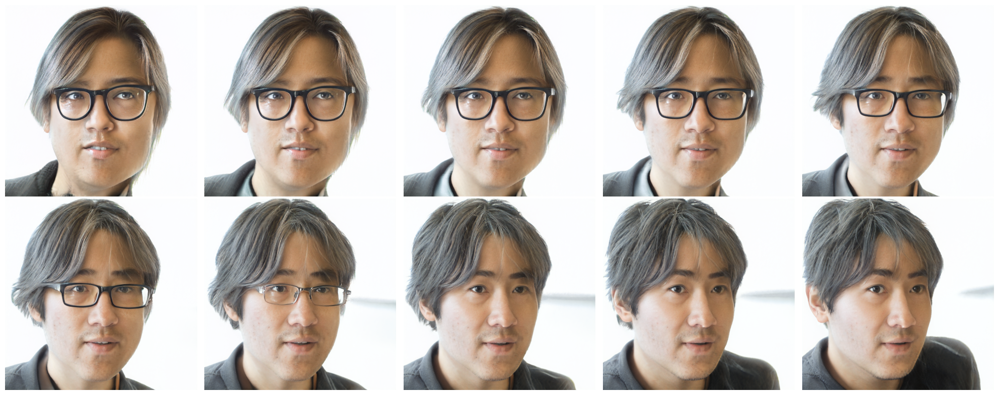

In [46]:
#Gender, rotate, age, background
directions = [2]
layers =list(range(0, 18))
img_list_gender_rotate_age ,X_list_gender_rotate_age = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_rotate_age_all',random_seed=2)

plot_results(img_list_gender_rotate_age, X_list_gender_rotate_age)

### **One direction and layer wise**


#### Gender

Only hair changes and the rotation too

Editing video ...
Saving optimization progress video "output_directory_pca/gender_lw.mp4"
Video saved


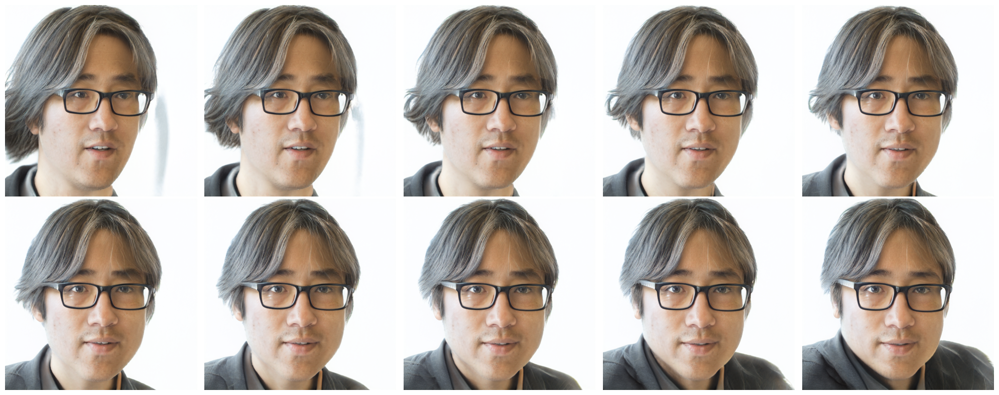

In [16]:
# Gender

directions = [1]
layers = [0,1,2]
img_list_gender_lw, X_list_gender_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='gender_lw',random_seed=2)

plot_results(img_list_gender_lw, X_list_gender_lw)

#### Age and hairstyle



Editing video ...
Saving optimization progress video "output_directory_pca/age_hairstyle_lw.mp4"
Video saved


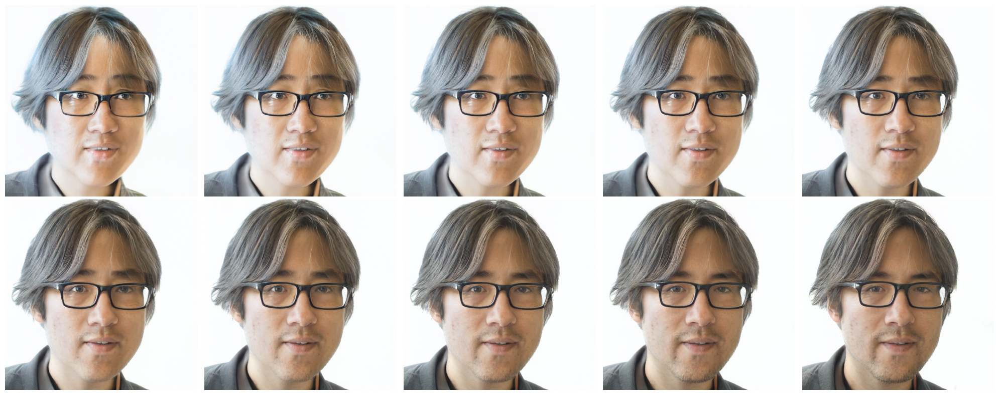

In [17]:
# Age and hairstyle

directions = [4]
layers = list(range(5, 18))
img_list_age_lw,X_list_age_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='age_hairstyle_lw',random_seed=2)


plot_results(img_list_age_lw, X_list_age_lw)

#### Hair color

We observe an evolution from black to black and white/grey

Editing video ...
Saving optimization progress video "output_directory_pca/hair_color_lw.mp4"
Video saved


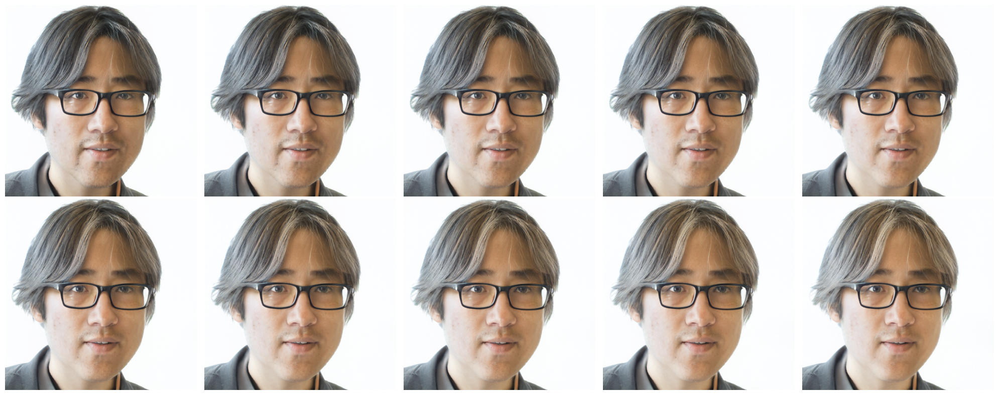

In [18]:
# Hair color

directions = [10]
layers = [7,8]
img_list_hair_color_lw, X_list_hair_color_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='hair_color_lw',random_seed=2)

plot_results(img_list_hair_color_lw, X_list_hair_color_lw)

#### Hair above forehead

Not much results there

Editing video ...
Saving optimization progress video "output_directory_pca/hair_forehead_lw.mp4"
Video saved


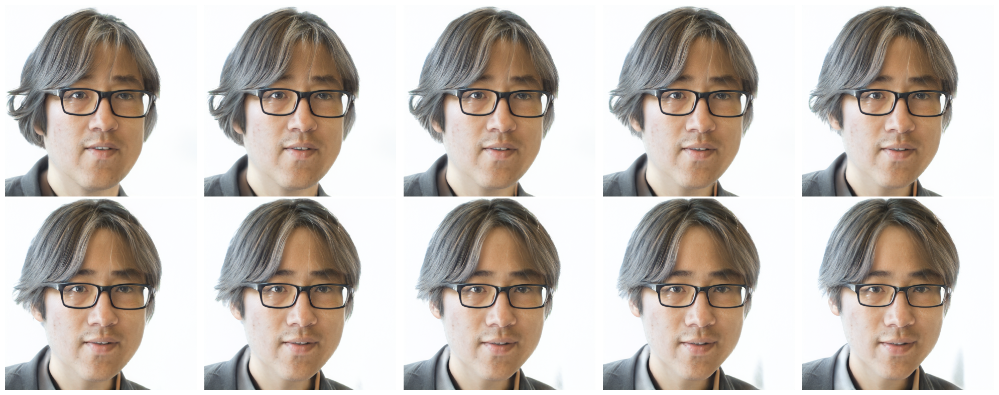

In [19]:
# Hair forehead

directions = [11]
layers = list(range(0, 5))
img_list_hair_forehead_lw,X_list_hair_forehead_lw  = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='hair_forehead_lw',random_seed=2)

plot_results(img_list_hair_forehead_lw, X_list_hair_forehead_lw)

#### Wrinkles

Here it seems that beard appear on the face

Editing video ...
Saving optimization progress video "output_directory_pca/wrinkles_lw.mp4"
Video saved


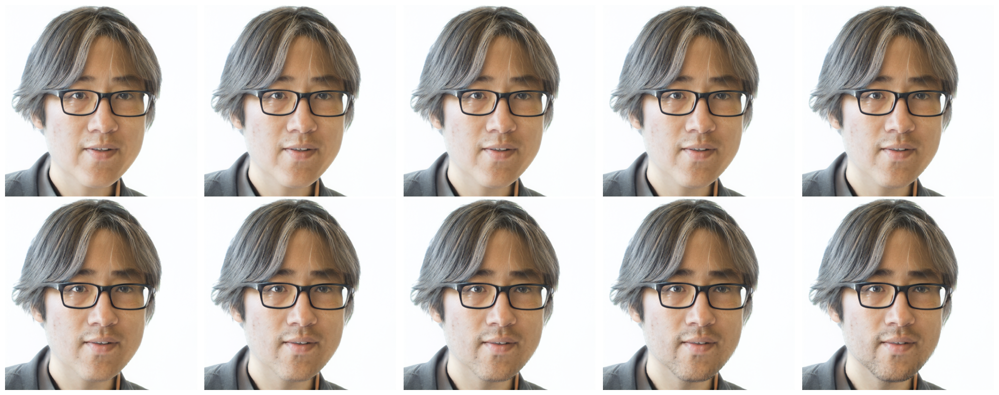

In [20]:
# Wrinkles

directions = [20]
layers = [6]
img_list_wrinkles_lw,X_list_wrinkles_lw  = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='wrinkles_lw',random_seed=2)

plot_results(img_list_wrinkles_lw, X_list_wrinkles_lw)

#### Expression

The person is slowly smiling

Editing video ...
Saving optimization progress video "output_directory_pca/expression_lw.mp4"
Video saved


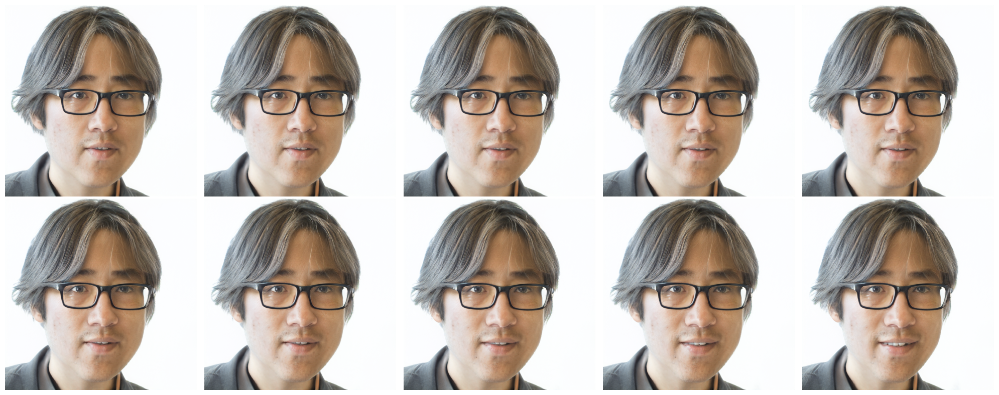

In [21]:
# Expression

directions = [23]
layers = [3,4,5]
img_list_expression_lw ,X_list_expression_lw = move_according_to_component(G, device,pca, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='expression_lw',random_seed=2)

plot_results(img_list_expression_lw, X_list_expression_lw)

# Attempts to disantanglement

---

## Kernel PCA instead of PCA

In [18]:
w_samples_kpca = generate_samples(G,5000)

KPCA = KernelPCA(n_components=100,  kernel='rbf', coef0=1,fit_inverse_transform=True)
scaler = StandardScaler()
w_samples_kpca = scaler.fit_transform(w_samples_kpca) 

In [29]:
KPCA.fit(w_samples_kpca)

KernelPCA(fit_inverse_transform=True, kernel='rbf', n_components=100)

In [19]:
#dump(KPCA, 'kpca_model_rbf_100compo_10000sampels.joblib')

In [19]:
KPCA_kernel = load('kpca_model_rbf_100compo_10000sampels.joblib')



**KPCA**

eigenvectors_ndarray of shape (n_samples, n_components)

eigenvalues_ndarray of shape (n_components,)

V_kpca : n_samples, n_components


In [20]:
z_sample = np.random.randn(1, 512).astype(np.float32) 
w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

w_sample = w_sample.cpu().numpy()
w_sample = w_sample[:, 1, :]  
w_sample = scaler.transform(w_sample)

X_transformed = KPCA_kernel.transform(w_sample) 
X_inv = KPCA_kernel.inverse_transform(X_transformed) # Project original data to kernel principal components  # (if fit_inverse_transform=True) Map back to original space

In [21]:
w_transformed = KPCA_kernel.transform(w_sample)

# Initialize x in the KPCA-transformed space
x = np.zeros((w_transformed.shape[1], 1))
X = np.tile(x, (1, 100))
print(X.shape)

sigma = 20
start_value = -sigma
end_value =  sigma
arrays_between = np.linspace(start_value, end_value, 100 + 2)[1:-1]
X[1] = arrays_between

print(X.shape)

(100, 100)
(100, 100)


In [22]:
x_tmp = X[:,1]
x_tmp.reshape(1, -1)
movement = KPCA_kernel.inverse_transform(x_tmp.reshape(1, -1))
print( movement.shape)

(1, 512)


In [23]:
def move_according_to_component_kpca(G, device, kpca, outdir, directions,  layers, num_steps, save_video=True, title_vid = 'proj', random_seed=None):
    os.makedirs(outdir, exist_ok=True)

    if random_seed is not None:
        np.random.seed(random_seed)

    eigenvalues = kpca.eigenvalues_
    eigenvectors = kpca.eigenvectors_
   
    # Generate a random z vector
    z_sample = np.random.RandomState(random_seed).randn(1, 512).astype(np.float32) 
    w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

    # Generate the original image
    img_original = G.synthesis(w_sample, noise_mode='const')
    img_original = (img_original + 1) * (255 / 2)
    img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
    '''
    plt.imshow(img_original)
    plt.title('Original image')
    plt.axis('off')
    plt.show()
    '''

    # Convert w_sample to numpy and select the second element in the latent vector (w space)
    w_sample = w_sample.cpu().numpy()
    w_sample = w_sample[:, 1, :]  
    w_sample = scaler.transform(w_sample)

    img_list = []
    w_list = []

    # Initialize x
    w_transformed = kpca.transform(w_sample)

    # Initialize x in the KPCA-transformed space
    x = np.zeros((w_transformed.shape[1], 1))
    X = np.tile(x, (1, num_steps))


    # We use X to store the variations according to the selected dimension in one matrix 
    # as we dont move the same way on each direction

    for v in directions:
        sigma = np.sqrt(eigenvalues[v])
        print(sigma)
        start_value = -sigma
        end_value =  sigma
        arrays_between = np.linspace(start_value, end_value, num_steps + 2)[1:-1]
        X[v] = arrays_between
   
    # each line of X correspond to a direction, the columns represent the range from -2 sigma
    # to 2 sigma
    # So the vector x of the article is one of the column of X
    
    # X.shape[0] is the number of componets
    # X.shape[1] is the number of steps from -2 sigma to 2 sigma
    
    for i in range(X.shape[1]):
        x_tmp = X[:, i]
        
        movement = KPCA_kernel.inverse_transform(x_tmp.reshape(1, -1))
        
        # move according to direction in KPCA space
        w_new = w_sample + movement
        w_new = scaler.inverse_transform(w_new)
        
        W = np.tile(scaler.inverse_transform(w_sample), (1, 18, 1))
        W[:, layers, :] = w_new
        w_list.append(W)

    '''
    for scalar in tqdm(arrays_between):
        w_pca = pca.transform(w_sample)
        w_pca[:, component_index] += scalar
        w_new_single = pca.inverse_transform(w_pca)

        w_new = np.tile(w_new_single[:, np.newaxis, :], (1, 18, 1))
        w_list.append(w_new)
    '''
    video = imageio.get_writer(f'{outdir}/{title_vid}.mp4', mode='I', fps=10, codec='libx264', bitrate='16M')
    for w_modified in w_list:
            w_modified_tensor = torch.from_numpy(w_modified).to(device)
            synth_image = G.synthesis(w_modified_tensor, noise_mode='const')
            synth_image = (synth_image + 1) * (255 / 2)
            synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
            img_list.append(synth_image)
        

    for synthetic_image in img_list:
        video.append_data(np.concatenate([img_original, synthetic_image], axis=1))

    if save_video: 
        print("Editing video ...")
        os.makedirs(outdir, exist_ok=True)
        print(f'Saving optimization progress video "{outdir}/{title_vid}.mp4"')
        
        video.close()
        print("Video saved")
    
    return img_list, X

### testing KPCA with all layers in the first directions

4.3453536
Editing video ...
Saving optimization progress video "output_directory_pca/test_kpca.mp4"
Video saved


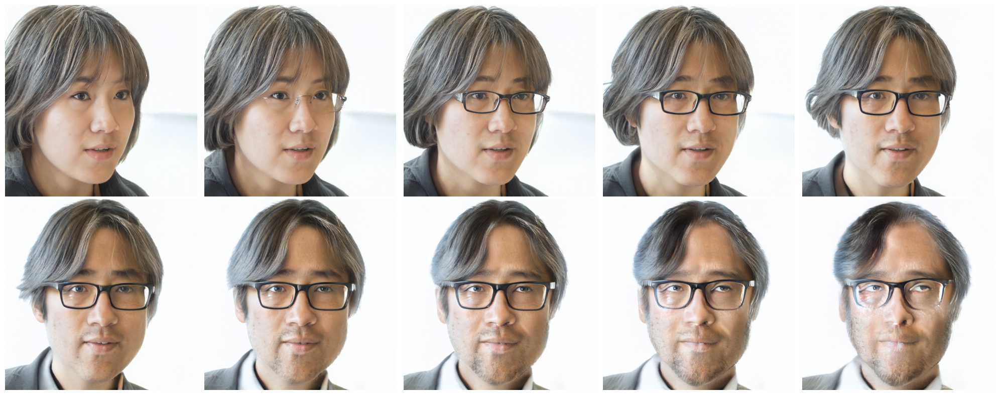

In [32]:
# Test with KPCA
directions = [0]
layers =list(range(0, 18))
img_list , X_list = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='test_kpca',random_seed=2)

plot_results(img_list, X_list)

4.23369
Editing video ...
Saving optimization progress video "output_directory_pca/test_kpca.mp4"
Video saved


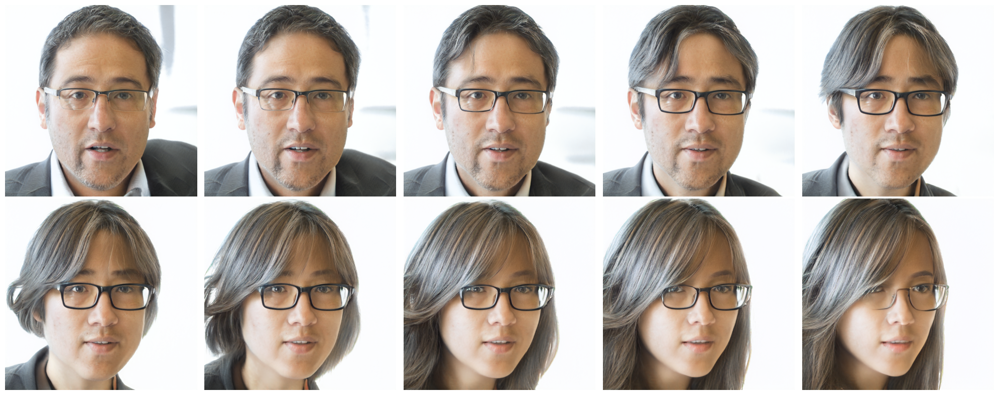

In [33]:
directions = [1]
layers =list(range(0, 18))
img_list , X_list = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='test_kpca',random_seed=2)

plot_results(img_list, X_list)

3.9368377


Editing video ...
Saving optimization progress video "output_directory_pca/test_kpca.mp4"
Video saved


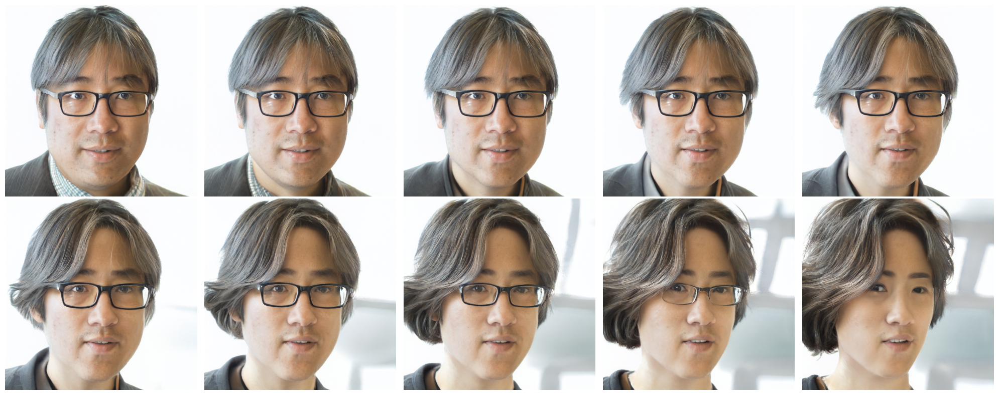

In [45]:
directions = [2]
layers =list(range(0, 18))
img_list , X_list = move_according_to_component_kpca(G, device,KPCA_kernel, 'output_directory_pca', directions=directions, layers = layers, num_steps=100,save_video=True, title_vid='test_kpca',random_seed=2)

plot_results(img_list, X_list)

### Comparison between PCA and KPCA space


In [13]:
z_sample = np.random.randn(1, 512).astype(np.float32) 
w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

w_sample = w_sample.cpu().numpy()
w_sample = w_sample[:, 1, :]  
w_sample = scaler.transform(w_sample)

In [43]:
def create_deplacement_pca(pca,direction):

    # displacement using pca
    V = pca.components_.T
    explained_variance = pca.explained_variance_

    x_pca = np.zeros((V.shape[1], 1))
    X_pca =  np.tile(x_pca, (1, 100))

    sigma = np.sqrt(explained_variance[direction])
    start_value = -2* sigma
    end_value = 2* sigma
    arrays_between = np.linspace(start_value, end_value, 100 + 2)[1:-1]
    X_pca[direction] = arrays_between
    
    deplacement_list_pca = []

    for i in range(X_pca.shape[1]):
        x_tmp = X[:,i]
        movement = V @ x_tmp
        movement = np.expand_dims(movement, axis=1)
        deplacement_list_pca.append(movement.T)

    return deplacement_list_pca


def create_deplacement_kpca(kpca,direction):
    w_transformed = kpca.transform(w_sample)
    eigenvalues = kpca.eigenvalues_

    x_kpca = np.zeros((w_transformed.shape[1], 1))
    X_kpca =  np.tile(x_kpca, (1, 100))

    sigma = np.sqrt(eigenvalues[direction])
    start_value = -2* sigma
    end_value = 2* sigma
    arrays_between = np.linspace(start_value, end_value, 100 + 2)[1:-1]
    X_kpca[direction] = arrays_between
    
    deplacement_list_kpca = []

    for i in range(X_kpca.shape[1]):
        x_tmp = X[:,i]
        movement = kpca.inverse_transform(x_tmp.reshape(1, -1))
        deplacement_list_kpca.append(movement)
        
    return deplacement_list_kpca

deplacement_list_pca = create_deplacement_pca(pca,0)

**KPCA with rbf kernel**

In [44]:
deplacement_list_kpca_rbf = create_deplacement_kpca(KPCA_kernel,0)

euclidean_distance_2sigma = np.linalg.norm(deplacement_list_kpca_rbf[0] - deplacement_list_pca[0])
print(euclidean_distance_2sigma)


cosine_sim = cosine_similarity(deplacement_list_kpca_rbf[0] , deplacement_list_pca[0])
print(cosine_sim)

## Tryning to use a Variational Auto encoder instead of a PCA

---

Motivation:

PCA is a linear technique, whereas Autoencoders can learn non-linear representations of data, so maybe it can learn a more complex representation in which the features we are interested in are 

In [14]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from sklearn.preprocessing import StandardScaler
from torch.optim.lr_scheduler import ReduceLROnPlateau

class VAE(nn.Module):
    def __init__(self, input_dim, hidden_dim, latent_dim):
        super(VAE, self).__init__()
        
        # Encoder
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim // 2),
            nn.ReLU(),
            nn.Linear(hidden_dim // 2, hidden_dim // 4),
            nn.ReLU(),
            nn.Linear(hidden_dim // 4, latent_dim * 2)  # 2 for mean and variance
        )
        
        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim // 4),
            nn.ReLU(),
            nn.Linear(hidden_dim // 4, hidden_dim // 2),
            nn.ReLU(),
            nn.Linear(hidden_dim // 2, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, input_dim),
            nn.Sigmoid()
        )

        
    def encode(self, x):
        h = self.encoder(x)
        mean, log_var = torch.chunk(h, 2, dim=1)
        return mean, log_var
    
    def reparameterize(self, mean, log_var):
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mean + eps * std
    
    def decode(self, z):
        return self.decoder(z)
    
    def forward(self, x):
        mean, log_var = self.encode(x)
        z = self.reparameterize(mean, log_var)
        x_recon = self.decode(z)
        return x_recon, mean, log_var

# Define loss function
def loss_function(recon_x, x, mean, log_var):
    BCE = nn.functional.binary_cross_entropy(recon_x, x, reduction='sum')
    KLD = -0.5 * torch.sum(1 + log_var - mean.pow(2) - log_var.exp())
    return BCE + KLD

# Parameters
input_dim = 512
hidden_dim = 256
latent_dim = 100
batch_size = 16
epochs = 10
learning_rate = 1e-2

w_samples_vae = generate_samples(G,10)
scaler = StandardScaler()
w_samples_normalized = scaler.fit_transform(w_samples_vae)



# Min-max scaling to [0, 1]
min_val = w_samples_normalized.min()
max_val = w_samples_normalized.max()
w_samples_scaled = (w_samples_normalized - min_val) / (max_val - min_val)


pca = PCA(n_components=hidden_dim)  # Choose the number of PCA components
pca.fit(w_samples_scaled)

# Get PCA components
pca_components = pca.components_


# Create DataLoader
dataset = TensorDataset(torch.tensor(w_samples_scaled, dtype=torch.float32))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)


# Initialize the VAE model with PCA components
vae = VAE(input_dim, hidden_dim, latent_dim).to(device)

# Replace the first layers of the encoder with PCA components
vae.encoder[0] = nn.Linear(input_dim, hidden_dim, bias=False)
vae.encoder[0].weight.data = torch.tensor(pca_components, dtype=torch.float32).to(device)


optimizer = optim.Adam(vae.parameters(), lr=learning_rate)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

# Training loop
for epoch in range(epochs):
    for data in dataloader:
        x = data[0].to(device)
        x_recon, mean, log_var = vae(x)

        loss = loss_function(x_recon, x, mean, log_var)
        scheduler.step(loss)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    
    print(f'Epoch {epoch + 1}, Loss: {loss.item()}')

print("Training complete.")

torch.save(vae.state_dict(), 'vae_model.pth')

KeyboardInterrupt: 

In [16]:
def encode_decode_sample(vae, scaler, sample):
 
    vae.eval()
    
    # Preprocess the sample
    sample = scaler.transform(sample)  
    
    sample_tensor = torch.tensor(sample, dtype=torch.float32).to(device)
    
    # Encode the sample
    with torch.no_grad():
        mean, log_var = vae.encode(sample_tensor)
        z = vae.reparameterize(mean, log_var)
    
    # Decode the latent code
    with torch.no_grad():
        reconstructed_sample = vae.decode(z)
    
    reconstructed_sample = reconstructed_sample.cpu().numpy()
    reconstructed_sample = scaler.inverse_transform(reconstructed_sample)
    
    return reconstructed_sample

z_sample = np.random.RandomState(2).randn(1, 512).astype(np.float32) 
w_sample = G.mapping(torch.from_numpy(z_sample).to(device), None)

# Generate the original image
img_original = G.synthesis(w_sample, noise_mode='const')
img_original = (img_original + 1) * (255 / 2)
img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()


# Convert w_sample to numpy and select the second element in the latent vector (w space)
w_sample = w_sample.cpu().numpy()
w_sample = w_sample[:, 1, :]  

reconstructed_sample = encode_decode_sample(vae, scaler, w_sample)

euclidean_distance_2sigma = np.linalg.norm(w_sample - reconstructed_sample)
print(euclidean_distance_2sigma)

9.850294


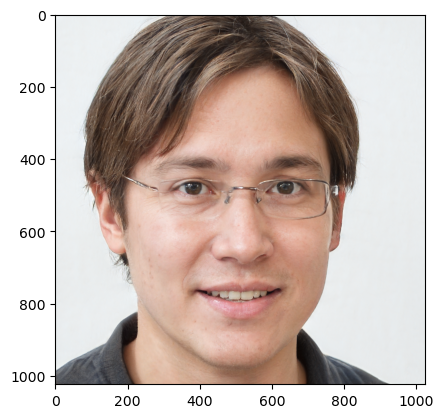

In [17]:
W_or= np.tile(scaler.inverse_transform(w_sample), (1, 18, 1))
W_or_tensor = torch.tensor(W_or, dtype=torch.float32).to(device)
img_original = G.synthesis(W_or_tensor, noise_mode='const')
img_original = (img_original + 1) * (255 / 2)
img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()

plt.imshow(img_original)

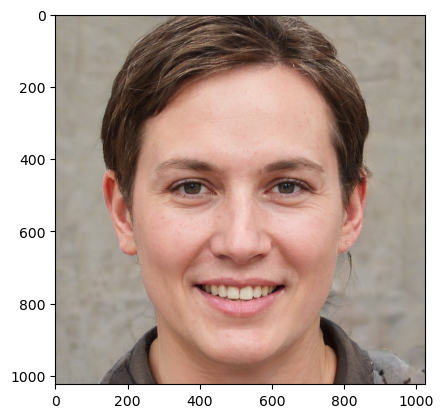

In [18]:
W_or= np.tile(scaler.inverse_transform(reconstructed_sample), (1, 18, 1))
W_or_tensor = torch.tensor(W_or, dtype=torch.float32).to(device)
img_original = G.synthesis(W_or_tensor, noise_mode='const')
img_original = (img_original + 1) * (255 / 2)
img_original = img_original.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()

plt.imshow(img_original)